In [71]:
# Importing the packages

import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from nltk.tokenize.treebank import TreebankWordDetokenizer
from nltk.corpus import stopwords
from nltk import word_tokenize

pd.set_option('display.max_rows', 500)
%matplotlib inline
sns.set()
sns.set_style("ticks")

In [72]:
# Uploading data and adjusting data

df1 = pd.read_csv('winemag-data-130k-v2.csv', encoding='latin1')
df2 = pd.read_csv('winemag-data_first150k.csv', encoding='latin1')
df = pd.concat([df1,df2],sort = False)
df = df.drop(['Unnamed: 0'], axis = 1)
df = df.drop_duplicates().reset_index(drop=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 217839 entries, 0 to 217838
Data columns (total 13 columns):
country                  217777 non-null object
description              217839 non-null object
designation              153398 non-null object
points                   217839 non-null int64
price                    200724 non-null float64
province                 217777 non-null object
region_1                 182347 non-null object
region_2                 86260 non-null object
taster_name              95071 non-null object
taster_twitter_handle    90542 non-null object
title                    119988 non-null object
variety                  217838 non-null object
winery                   217839 non-null object
dtypes: float64(1), int64(1), object(11)
memory usage: 21.6+ MB


In [73]:
# Adding grade based on points

def grades(points):
    if points in range(80,83):
        return 0
    elif points in range(83,87):
        return 1
    elif points in range(87,90):
        return 2
    elif points in range(90,94):
        return 3
    elif points in range(94,98):
        return 4
    else:
        return 5
    
df['grade'] = df['points'].apply(grades)

    introducing the dollar per point ratio in order to be more specific while choosing

In [74]:
df['ratio'] = df['price']/df['points']

#### Points

In [75]:
df['points'].describe()

count    217839.000000
mean         88.224152
std           3.159017
min          80.000000
25%          86.000000
50%          88.000000
75%          90.000000
max         100.000000
Name: points, dtype: float64

In [76]:
# Plotting the histogram

tips = px.data.tips()
fig = px.histogram(tips, x = df['points'], color = df['grade'])

# Edit the layout
fig.update_layout(title='Points in the dataset',
                   xaxis_title='Points',
                   yaxis_title='Frequency')

fig.show()

In [77]:
# Plotting the boxplot

tips = px.data.tips()
fig = px.box(tips, y=df['points'])

# Edit the layout
fig.update_layout(title='Distribution of points',
                   yaxis_title='Points')

fig.show()

In [78]:
# Let's check these top 25%

df['points'].quantile(np.arange(0.75,1,.01))

0.75    90.0
0.76    91.0
0.77    91.0
0.78    91.0
0.79    91.0
0.80    91.0
0.81    91.0
0.82    91.0
0.83    91.0
0.84    92.0
0.85    92.0
0.86    92.0
0.87    92.0
0.88    92.0
0.89    92.0
0.90    92.0
0.91    93.0
0.92    93.0
0.93    93.0
0.94    93.0
0.95    93.0
0.96    94.0
0.97    94.0
0.98    94.0
0.99    95.0
Name: points, dtype: float64

    the top 1% was graded with more than 95 points

#### Price

In [79]:
df['price'].describe()

count    200724.000000
mean         34.749542
std          40.207151
min           4.000000
25%          16.000000
50%          25.000000
75%          40.000000
max        3300.000000
Name: price, dtype: float64

    there are prices shown for 200724 of the reviews
    the average price is 34.75 USD
    the lowest price is 4 USD
    top 25% of all wines were listed with the price higher than 40 USD
    the most expensive one was sold for 3300 USD

Text(0.5, 1.0, 'Prices')

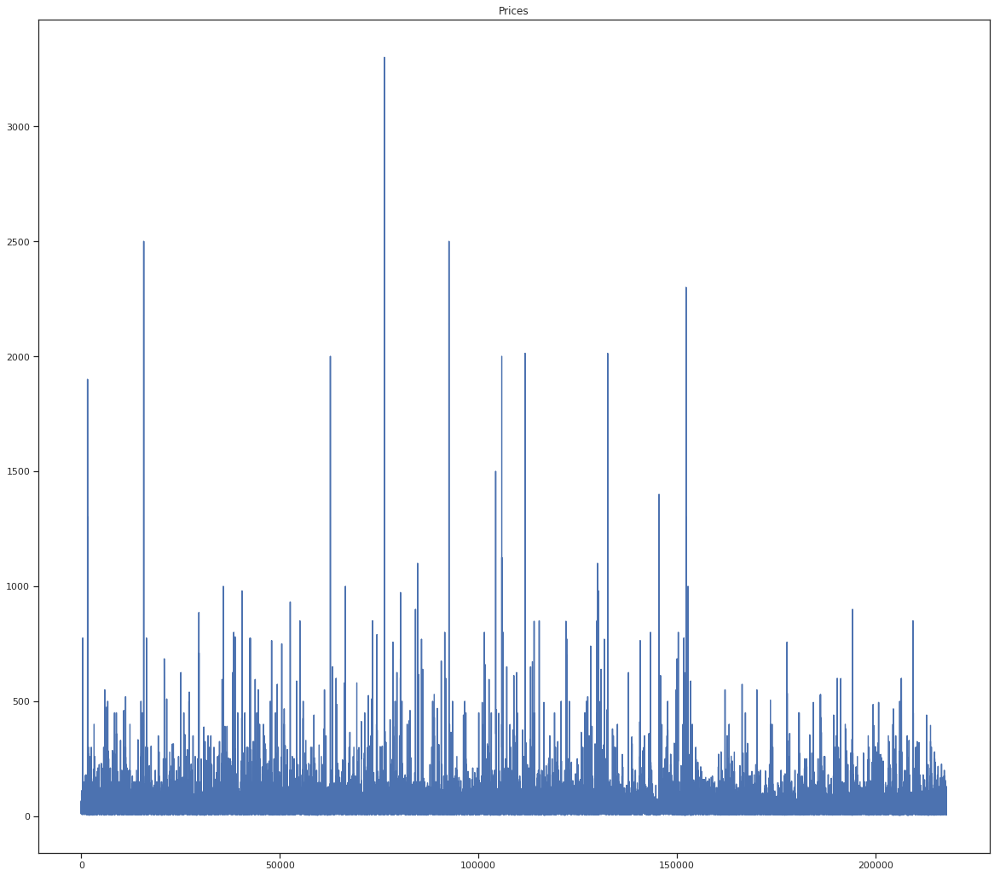

In [80]:
# Plotting the price

plt.figure(figsize = (20,18))
plt.plot(df['price'])
plt.title('Prices')

    we can see the extreme values all over the graph, let's expect them
    using the boxplot

In [11]:
# Plotting the boxplot

tips = px.data.tips()
fig = px.box(tips, y=df['price'])

# Edit the layout
fig.update_layout(title='Distribution of price',
                   yaxis_title='Price')

fig.show()

    we can see, that lots of the people prefer drinking wine
    which costs more than 40 USD, let's check it

In [12]:
# Inspecting
df['price'].quantile(np.arange(0.75,1,.01))

0.75     40.0
0.76     42.0
0.77     44.0
0.78     45.0
0.79     45.0
0.80     47.0
0.81     48.0
0.82     50.0
0.83     50.0
0.84     50.0
0.85     54.0
0.86     55.0
0.87     57.0
0.88     60.0
0.89     60.0
0.90     65.0
0.91     65.0
0.92     70.0
0.93     75.0
0.94     78.0
0.95     85.0
0.96     90.0
0.97    100.0
0.98    120.0
0.99    155.0
Name: price, dtype: float64

        we can see a rapid increase in the price, especially in from the top 2% to top 1%

In [13]:
# Let's check the top 1%

df['price'].quantile(np.arange(0.99,1,.001))

0.990     155.0
0.991     168.0
0.992     175.0
0.993     194.0
0.994     200.0
0.995     225.0
0.996     250.0
0.997     292.0
0.998     350.0
0.999     460.0
1.000    3300.0
Name: price, dtype: float64

In [14]:
# Going deeper into 0.999

df['price'].quantile(np.arange(0.995,1,.0001))

0.9950     225.0000
0.9951     226.0000
0.9952     230.0000
0.9953     232.8057
0.9954     235.0000
0.9955     239.7465
0.9956     240.0000
0.9957     245.8911
0.9958     250.0000
0.9959     250.0000
0.9960     250.0000
0.9961     250.0000
0.9962     255.0000
0.9963     260.0000
0.9964     260.0000
0.9965     269.0000
0.9966     275.0000
0.9967     275.0000
0.9968     280.0000
0.9969     289.7587
0.9970     292.0000
0.9971     300.0000
0.9972     300.0000
0.9973     300.0000
0.9974     303.0000
0.9975     312.3850
0.9976     320.0000
0.9977     325.0000
0.9978     330.0000
0.9979     350.0000
0.9980     350.0000
0.9981     354.6263
0.9982     365.0000
0.9983     380.0000
0.9984     397.5296
0.9985     400.0000
0.9986     412.0000
0.9987     440.0000
0.9988     450.0000
0.9989     450.0000
0.9990     460.0000
0.9991     477.3972
0.9992     500.0000
0.9993     514.9390
0.9994     550.0000
0.9995     600.0000
0.9996     646.8188
0.9997     764.0000
0.9998     800.0000
0.9999    1100.0000


    i would suggest we will form this top 0.02% as a separate dataframe
    in order to get some interesting insides later

##### Luxury

In [15]:
# Creating a dataframe for luxury wines

luxury = df[df['price'] > 800 ]
luxury = luxury.reset_index(drop=True)
luxury.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 40 entries, 0 to 39
Data columns (total 15 columns):
country                  40 non-null object
description              40 non-null object
designation              14 non-null object
points                   40 non-null int64
price                    40 non-null float64
province                 40 non-null object
region_1                 35 non-null object
region_2                 2 non-null object
taster_name              25 non-null object
taster_twitter_handle    25 non-null object
title                    26 non-null object
variety                  40 non-null object
winery                   40 non-null object
grade                    40 non-null int64
ratio                    40 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 4.8+ KB


    creating this dataframe, which consists only wines which prices are above
    800 USD gave me an idea to divide all wines based on the prices into categories

##### Very Expensive

    this category would be from top 0.27% to 0.02%, which means
    from 300 to 800 USD (inkl.)

In [16]:
# Creating a dataframe for very_expensive wines

very_expensive = df[(df['price'] > 300) & (df['price'] < 800.01)]
very_expensive = very_expensive.reset_index(drop=True)
very_expensive.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 485 entries, 0 to 484
Data columns (total 15 columns):
country                  485 non-null object
description              485 non-null object
designation              311 non-null object
points                   485 non-null int64
price                    485 non-null float64
province                 485 non-null object
region_1                 398 non-null object
region_2                 30 non-null object
taster_name              257 non-null object
taster_twitter_handle    234 non-null object
title                    286 non-null object
variety                  485 non-null object
winery                   485 non-null object
grade                    485 non-null int64
ratio                    485 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 57.0+ KB


##### Expensive

        expensive one will be from top 0.27% to top 3%, it means from 100 to 300 USD (inkl.)

In [17]:
expensive = df[(df['price'] > 100) & (df['price'] < 300.01)]
expensive = expensive.reset_index(drop=True)
expensive.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5041 entries, 0 to 5040
Data columns (total 15 columns):
country                  5041 non-null object
description              5041 non-null object
designation              4162 non-null object
points                   5041 non-null int64
price                    5041 non-null float64
province                 5041 non-null object
region_1                 4666 non-null object
region_2                 1598 non-null object
taster_name              2276 non-null object
taster_twitter_handle    2226 non-null object
title                    2917 non-null object
variety                  5041 non-null object
winery                   5041 non-null object
grade                    5041 non-null int64
ratio                    5041 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 590.9+ KB


##### Medium

    next one would be all the wines from 40(75%-quantile) and up to 100 USD

In [18]:
medium = df[(df['price'] > 40) & (df['price'] < 100.01)]
medium = medium.reset_index(drop=True)
medium.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 44573 entries, 0 to 44572
Data columns (total 15 columns):
country                  44571 non-null object
description              44573 non-null object
designation              36962 non-null object
points                   44573 non-null int64
price                    44573 non-null float64
province                 44571 non-null object
region_1                 40466 non-null object
region_2                 23074 non-null object
taster_name              19691 non-null object
taster_twitter_handle    19121 non-null object
title                    25922 non-null object
variety                  44573 non-null object
winery                   44573 non-null object
grade                    44573 non-null int64
ratio                    44573 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 5.1+ MB


##### Low

    low category is all the wines from 25 and up to 40 USD

In [19]:
low = df[(df['price'] > 25) & (df['price'] < 40.01)]
low = low.reset_index(drop=True)
low.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 46110 entries, 0 to 46109
Data columns (total 15 columns):
country                  46090 non-null object
description              46110 non-null object
designation              33875 non-null object
points                   46110 non-null int64
price                    46110 non-null float64
province                 46090 non-null object
region_1                 40845 non-null object
region_2                 25624 non-null object
taster_name              20042 non-null object
taster_twitter_handle    19002 non-null object
title                    26011 non-null object
variety                  46110 non-null object
winery                   46110 non-null object
grade                    46110 non-null int64
ratio                    46110 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 5.3+ MB


##### Cheap

    cheap are all from 0 to 25 USD

In [20]:
cheap = df[(df['price'] > 0) & (df['price'] < 25.01)]
cheap = cheap.reset_index(drop=True)
cheap.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 104475 entries, 0 to 104474
Data columns (total 15 columns):
country                  104439 non-null object
description              104475 non-null object
designation              65706 non-null object
points                   104475 non-null int64
price                    104475 non-null float64
province                 104439 non-null object
region_1                 81776 non-null object
region_2                 35547 non-null object
taster_name              46029 non-null object
taster_twitter_handle    43229 non-null object
title                    56431 non-null object
variety                  104474 non-null object
winery                   104475 non-null object
grade                    104475 non-null int64
ratio                    104475 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 12.0+ MB


### Analysis

    Let's plot all the dataframes together in order to 
    analyze the distribution of prices by grade in different categories

#### Part 1

Text(0.5, 1.0, 'Exprensive')

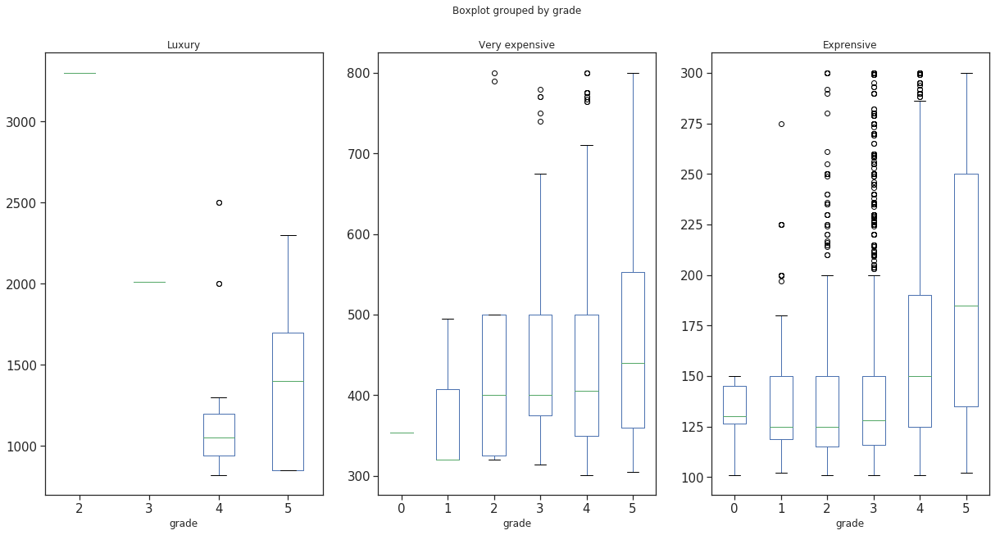

In [21]:
# Plotting price categories (luxury, very_expensive, expensive) as boxplots by grades

fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,10))

luxury.boxplot(ax = axes[0], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Luxury')
very_expensive.boxplot(ax = axes[1], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Very expensive')
expensive.boxplot(ax = axes[2], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Exprensive')

#### Part 2

Text(0.5, 1.0, 'Cheap')

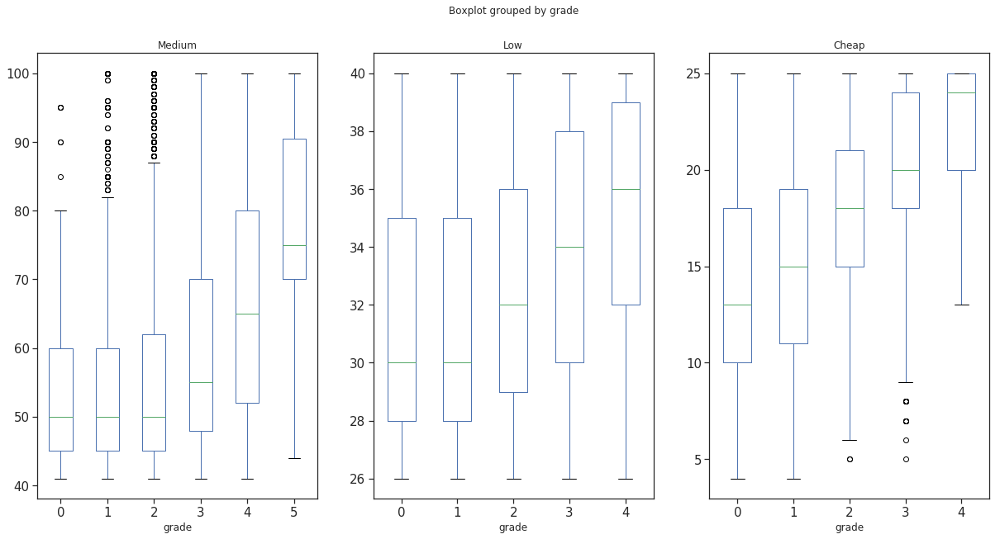

In [22]:
# Plotting price categories (medium, low, cheap) as boxplots by grades

fig, axes = plt.subplots(nrows = 1, ncols = 3, figsize = (20,10))

medium.boxplot(ax = axes[0], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Medium')
low.boxplot(ax = axes[1], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Low')
cheap.boxplot(ax = axes[2], column = 'price', by = 'grade', grid=False, fontsize=15).set_title('Cheap')

    since it is a huge dataset, we might want to find a starting point
    in our case, in order to test the assumption that france is the most wine country,
    we need to analyze each category that we splitted
    let's start with the biggest one and the most relevant for everyday use - the cheap one

#### Cheap wines

    let's have a quick look

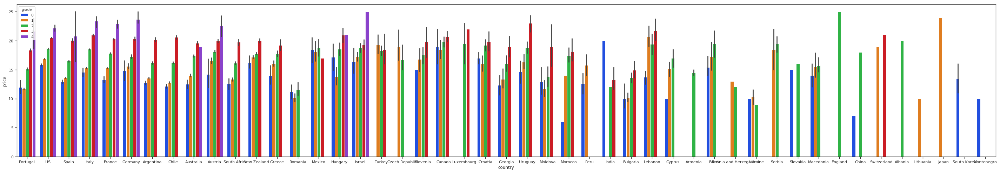

In [23]:
plt.figure(figsize=(50,8))
sns.barplot(x = 'country', y = 'price', hue = 'grade', data = cheap, palette="bright")

    we might decide to remove the low rankings such as grades 0,1,2 and
    remove the country with small frequency

In [24]:
cheap['country'].value_counts()

US                        38003
France                    13960
Italy                     13214
Spain                      8064
Chile                      6636
Argentina                  5485
Portugal                   5181
Australia                  3282
Austria                    2258
New Zealand                2060
South Africa               1931
Germany                    1689
Greece                      719
Israel                      419
Romania                     194
Bulgaria                    178
Canada                      158
Hungary                     136
Uruguay                     106
Croatia                      99
Turkey                       90
Moldova                      86
Georgia                      83
Slovenia                     81
Mexico                       71
Lebanon                      37
Brazil                       36
Morocco                      31
Cyprus                       25
Macedonia                    23
Ukraine                      19
India   

In [25]:
cheap['grade'].value_counts()

1    42977
2    40961
3    14805
0     5569
4      163
Name: grade, dtype: int64

In [26]:
cheap_but_good = cheap[cheap['grade'] > 2].copy()
cheap_but_good = cheap_but_good.reset_index(drop=True)
cheap_but_good.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 14968 entries, 0 to 14967
Data columns (total 15 columns):
country                  14962 non-null object
description              14968 non-null object
designation              10345 non-null object
points                   14968 non-null int64
price                    14968 non-null float64
province                 14962 non-null object
region_1                 11300 non-null object
region_2                 5810 non-null object
taster_name              8100 non-null object
taster_twitter_handle    7647 non-null object
title                    8957 non-null object
variety                  14968 non-null object
winery                   14968 non-null object
grade                    14968 non-null int64
ratio                    14968 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 1.7+ MB


In [27]:
cheap_but_good['ratio'].describe()

count    14968.000000
mean         0.222962
std          0.041804
min          0.055556
25%          0.197802
50%          0.222222
75%          0.263736
max          0.277778
Name: ratio, dtype: float64

In [28]:
# top 25%

cheap_but_good = cheap_but_good[cheap_but_good['ratio'] > 0.26365].reset_index(drop=True)

In [29]:
cheap_but_good.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3892 entries, 0 to 3891
Data columns (total 15 columns):
country                  3891 non-null object
description              3892 non-null object
designation              2786 non-null object
points                   3892 non-null int64
price                    3892 non-null float64
province                 3891 non-null object
region_1                 3144 non-null object
region_2                 1733 non-null object
taster_name              2063 non-null object
taster_twitter_handle    1956 non-null object
title                    2361 non-null object
variety                  3892 non-null object
winery                   3892 non-null object
grade                    3892 non-null int64
ratio                    3892 non-null float64
dtypes: float64(2), int64(2), object(11)
memory usage: 456.2+ KB


In [30]:
cheap_but_good['country'].value_counts()

US              1788
France           609
Italy            368
Austria          188
Portugal         181
Spain            169
Argentina        110
Chile            102
Germany           93
Australia         83
New Zealand       82
South Africa      39
Israel            23
Canada            18
Hungary           11
Greece            10
Georgia            4
Uruguay            3
Croatia            2
Slovenia           2
Bulgaria           2
Lebanon            1
Turkey             1
Morocco            1
Moldova            1
Name: country, dtype: int64

In [31]:
cheap_but_good = cheap_but_good.groupby('country').filter(lambda x: len(x) > 100)

In [32]:
cheap_but_good['country'].value_counts()

US           1788
France        609
Italy         368
Austria       188
Portugal      181
Spain         169
Argentina     110
Chile         102
Name: country, dtype: int64

In [33]:
cheap_but_good['grade'].value_counts()

3    3477
4      38
Name: grade, dtype: int64

In [34]:
# Displaying the findings from cheap group

tips = px.data.tips()
fig = px.histogram(tips, x=cheap_but_good['country'], color=cheap_but_good['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in cheap category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    as we can see here, the USA has the biggest sample as well as 20 wines voted for grade 4 vs France
    having only 10 voted for grade 4 vs Italy 1
    but does it mean that the USA has better wines?
    
    let's check other categories

#### Low wines

In [35]:
low['country'].value_counts()

US                26918
Italy              5632
France             5036
Spain              1613
Austria            1027
Portugal            973
Australia           945
Germany             782
Argentina           680
Chile               636
New Zealand         580
South Africa        456
Israel              213
Greece              185
Canada              114
Hungary              48
Slovenia             38
Mexico               37
Turkey               27
Croatia              21
Georgia              21
Brazil               18
Uruguay              18
Moldova              14
England              14
Lebanon              10
Bulgaria              8
Romania               7
Switzerland           5
Morocco               4
Serbia                4
Luxembourg            4
Czech Republic        1
China                 1
Name: country, dtype: int64

In [36]:
low['grade'].value_counts()

3    18971
2    16948
1     8304
4      978
0      909
Name: grade, dtype: int64

In [37]:
low['ratio'].describe()

count    46110.000000
mean         0.371473
std          0.050085
min          0.273684
25%          0.329545
50%          0.366667
75%          0.413043
max          0.500000
Name: ratio, dtype: float64

In [38]:
low_but_good = low[low['grade'] > 2].copy()
low_but_good = low_but_good.reset_index(drop=True)
low_but_good = low_but_good[low_but_good['ratio'] > 0.4130425].reset_index(drop=True)
low_but_good = low_but_good.groupby('country').filter(lambda x: len(x) > 100)

In [39]:
low_but_good['country'].value_counts()

US           2917
Italy         692
France        585
Austria       151
Portugal      143
Spain         132
Australia     114
Name: country, dtype: int64

In [40]:
low_but_good['grade'].value_counts()

3    4456
4     278
Name: grade, dtype: int64

In [41]:
# Displaying the findings from low group

tips = px.data.tips()
fig = px.histogram(tips, x=low_but_good['country'], color=low_but_good['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in low category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    the USA has the biggest sample as well as 181 wines voted for grade 4 vs France
    having only 33 voted for grade 4 and Italy only 30

#### Medium wines

In [42]:
medium['country'].value_counts()

US                24021
Italy              7739
France             5776
Spain              1387
Portugal            946
Australia           852
Austria             811
Germany             767
Argentina           625
Chile               504
New Zealand         335
South Africa        260
Israel              171
Canada               98
Hungary              68
Greece               57
England              52
Uruguay              21
Slovenia             16
Croatia              15
Mexico               12
Lebanon              12
Turkey                7
Romania               5
Brazil                4
Serbia                2
Moldova               2
Bulgaria              2
US-France             1
Czech Republic        1
Peru                  1
Luxembourg            1
Name: country, dtype: int64

In [43]:
medium['grade'].value_counts()

3    25302
2    10215
4     5531
1     3226
0      239
5       60
Name: grade, dtype: int64

In [44]:
medium['ratio'].describe()

count    44573.000000
mean         0.659085
std          0.164662
min          0.427083
25%          0.529412
50%          0.611111
75%          0.755814
max          1.204819
Name: ratio, dtype: float64

In [45]:
medium_but_good = medium[medium['grade'] > 3].copy()
medium_but_good = medium_but_good.reset_index(drop=True)
medium_but_good = medium_but_good[medium_but_good['ratio'] > 0.7558135].reset_index(drop=True)
medium_but_good = medium_but_good.groupby('country').filter(lambda x: len(x) > 100)

In [46]:
medium_but_good['country'].value_counts()

US        1093
Italy      345
France     326
Name: country, dtype: int64

In [47]:
medium_but_good['grade'].value_counts()

4    1727
5      37
Name: grade, dtype: int64

In [48]:
# Displaying the findings from medium group

tips = px.data.tips()
fig = px.histogram(tips, x=medium_but_good['country'], color=medium_but_good['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in medium category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    USA voted 33 times on grade 5, Italy 3 times, France only 1 time

#### Expensive wines

In [49]:
expensive['country'].value_counts()

US              1614
France          1424
Italy            996
Spain            328
Australia        171
Germany          141
Argentina        131
Portugal         105
Chile             49
Austria           35
New Zealand       11
South Africa      11
Hungary           10
Israel             4
Switzerland        2
Mexico             2
Canada             2
Uruguay            2
Turkey             2
Greece             1
Name: country, dtype: int64

In [50]:
expensive['grade'].value_counts()

3    2417
4    1935
2     468
1     116
5      99
0       6
Name: grade, dtype: int64

In [51]:
expensive['ratio'].describe()

count    5041.000000
mean        1.624318
std         0.485761
min         1.040816
25%         1.290323
50%         1.451613
75%         1.808989
max         3.448276
Name: ratio, dtype: float64

In [52]:
expensive_wine = expensive[expensive['grade'] > 3].copy()
expensive_wine = expensive_wine.reset_index(drop=True)
expensive_wine = expensive_wine[expensive_wine['ratio'] > 1.80898985].reset_index(drop=True)
expensive_wine = expensive_wine.groupby('country').filter(lambda x: len(x) > 100)

In [53]:
expensive_wine['country'].value_counts()

France    256
US        195
Italy     110
Name: country, dtype: int64

In [54]:
expensive_wine['grade'].value_counts()

4    516
5     45
Name: grade, dtype: int64

In [55]:
# Displaying the findings from expensive group

tips = px.data.tips()
fig = px.histogram(tips, x=expensive_wine['country'], color=expensive_wine['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in expensive category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    USA voted on grade 5 20 times, Italy 21 times and France 4 times

#### Very expensive wine

In [56]:
very_expensive['country'].value_counts()

France          249
Italy            78
Germany          54
US               31
Spain            27
Portugal         21
Australia        13
Chile             5
Hungary           4
Romania           2
South Africa      1
Name: country, dtype: int64

In [57]:
very_expensive['grade'].value_counts()

4    344
3     77
5     48
2     12
1      3
0      1
Name: grade, dtype: int64

In [58]:
very_expensive['ratio'].describe()

count    485.000000
mean       4.689525
std        1.285571
min        3.112245
25%        3.723404
50%        4.370370
75%        5.263158
max        9.195402
Name: ratio, dtype: float64

In [59]:
very_expensive_wine = very_expensive[very_expensive['grade'] > 3].copy()
very_expensive_wine = very_expensive_wine.reset_index(drop=True)
very_expensive_wine = very_expensive_wine[very_expensive_wine['ratio'] > 5.2631579].reset_index(drop=True)
very_expensive_wine = very_expensive_wine.groupby('country').filter(lambda x: len(x) > 15)

In [60]:
very_expensive_wine['country'].value_counts()

France    50
Name: country, dtype: int64

In [61]:
very_expensive_wine['grade'].value_counts()

4    42
5     8
Name: grade, dtype: int64

In [62]:
# Displaying the findings from very expensive group

tips = px.data.tips()
fig = px.histogram(tips, x=very_expensive_wine['country'], color=very_expensive_wine['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in very expensive category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    only France with 8 wines voted on 5 grade

#### Luxury wine

In [63]:
luxury['country'].value_counts()

France       27
Australia     4
Portugal      3
Austria       2
US            2
Italy         2
Name: country, dtype: int64

In [64]:
luxury['grade'].value_counts()

4    26
5    11
3     2
2     1
Name: grade, dtype: int64

In [65]:
luxury['ratio'].describe()

count    40.000000
mean     14.033009
std       6.463985
min       8.480000
25%       9.574468
50%      11.521167
75%      16.096939
max      37.500000
Name: ratio, dtype: float64

In [66]:
luxury_wine = luxury[luxury['grade'] > 3].copy()
luxury_wine = luxury_wine.reset_index(drop=True)
luxury_wine = luxury_wine[luxury_wine['ratio'] > 16.096939].reset_index(drop=True)
luxury_wine = luxury_wine.groupby('country').filter(lambda x: len(x) > 2)

In [67]:
luxury_wine['country'].value_counts()

France    7
Name: country, dtype: int64

In [68]:
luxury_wine['grade'].value_counts()

4    4
5    3
Name: grade, dtype: int64

In [69]:
# Displaying the findings from luxury group

tips = px.data.tips()
fig = px.histogram(tips, x=luxury_wine['country'], color=luxury_wine['grade']).update_xaxes(categoryorder = 'total descending')

# Edit the layout
fig.update_layout(title='Frequency of grades by country in luxury category',
                   xaxis_title='Countries',
                   yaxis_title='Grades')


fig.show()

    France voted 3 times on grade 5 in luxury category

In [70]:
iris = px.data.iris()
fig = px.scatter_3d(iris, x=df['points'], y=df['price'].index, z=df['country'].fillna('Unknown'),
              color=df['grade'])

# Edit the layout
fig.update_layout(title='Wine Reviews by Country and Grade',
                   xaxis_title='Points',
                   yaxis_title='Price')

# tight layout
fig.update_layout(margin=dict(l=0, r=0, b=0, t=0))

fig.show()

### Summary

    it seems like the most popular among the wines are the USA, France and Italy
    so let's look at them a bit more in details